# Synthetic Observations: 3D AMRVAC

We create synthetic observations for the Magritte model of the 3D AMRVAC snapshot that was created in the [this example](../1_post-processing/1_create_AMRVAC_3D.ipynb).

## Setup

Import the required functionalty.

In [1]:
import magritte.core     as magritte   # Core functionality
import magritte.plot     as plot       # Plotting

from astropy import units              # Unit conversions

Define a working directory (you will have to change this). We assume here that the scripts of the [this example](../1_post-processing/1_create_AMRVAC_3D.ipynb) have already been executed and go back to that working directory.

In [2]:
wdir = "/home/frederik/Magritte-examples/AMRVAC_3D/"

Define file names.

In [3]:
model_file = f'{wdir}model_AMRVAC_3D.hdf5'   # 3D AMRVAC Magritte model

Load the Magritte model.

In [4]:
model = magritte.Model(model_file)

## Model the medium

Initialize the model by setting up a spectral discretisation, computing the inverse line widths and initializing the level populations with their LTE values.

In [5]:
model.compute_spectral_discretisation ()
model.compute_inverse_line_widths     ()
model.compute_LTE_level_populations   ()

0

In this example we will work with the LTE level populations and **do not demand** statistical equilibrium.

In [6]:
# Iterate level populations until statistical equilibrium
# model.compute_level_populations (False, 1)

## Make synthetic observations

Now we can make synthetic observations of the model.

In [7]:
fcen = model.lines.lineProducingSpecies[0].linedata.frequency[0]
vpix = 1300   # velocity pixel size [m/s] 
dd   = vpix * (model.parameters.nfreqs()-1)/2 / magritte.CC
fmin = fcen - fcen*dd
fmax = fcen + fcen*dd

model.compute_spectral_discretisation (fmin, fmax)
model.compute_image (model.parameters.hnrays()-1)

0

## Plot observations

Plot the resulting channel maps with the Magritte plotly back end.

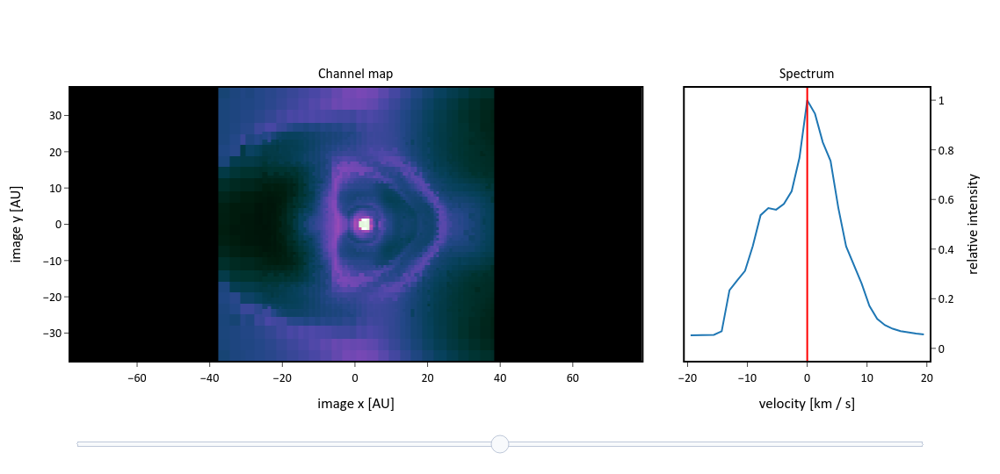

In [8]:
plot.image_plotly(
    model,
    image_nr =  -1,
    zoom     = 1.3,
    npix_x   = 100,
    npix_y   = 100,
    x_unit   = units.au,
    v_unit   = units.km / units.s
)

In [10]:
import ipywidgets

ipywidgets.IntSlider()

IntSlider(value=0)

In [ ]:
embed_minimal_html('export.html', views=[slider], title='Widgets export')